In this notebook, we tested a C3 to C5 phantom with an external solution containing around C=500g/L sugar

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cmath
import nibabel as nib
import cv2
from sklearn.linear_model import LinearRegression 
import scipy
from skimage.restoration import unwrap_phase
from scipy.io import savemat
from scipy.ndimage import gaussian_filter
from skimage.transform import rescale as resc
from skimage.transform import downscale_local_mean
import nibabel as nib
from matplotlib.gridspec import GridSpec
import matplotlib.gridspec as gridspec
from PIL import Image
from scipy import stats
import tqdm
from multiprocessing import Pool, cpu_count
import tikzplotlib

# I. Field maps

In [2]:
### parameters and constants
TE1=3.06*0.001 #s
TE2=4.08*0.001 #s
delta_TE=TE2-TE1
gamma = 2.675221900e8 # /s/T

In [3]:
def mask(path_mag1, material, tresh, plot=True, slice=71):
    '''
    Return a mask with 0 if inside the compound and 1 outside

    Parameters
    ----------
    path_mag1 : str
        path to the magnitude 1 of the compound.
    material : str
        description of the compound.
    tresh : float
        magnitude treshold of the mask.
    plot : bool, optional
        if true, plot a slice of the magnitude and of the mask. The default is True.
    slice : int, optional
        the slice to plot. The default is 71.

    Returns
    -------
    mask : numpy.ndarray
        mask of the compound.

    '''
    ######## magnitude #############
    mag1 = nib.load(path_mag1)
    data_mag1=mag1.get_fdata() #extract matrix with values
    
    mask = data_mag1 > tresh #return array of booleens
    
    
    #plot the selected slice 
    if plot==True:
        plt.figure(figsize=(8,5))
        plt.subplot(1,2,1)
        plt.imshow(data_mag1[:,:,slice])
        plt.colorbar()
        plt.title(f'Magnitude_1 of {material}')
    
        plt.subplot(1,2,2)
        plt.imshow(mask[:, :, slice])
        plt.colorbar()
        plt.title(f'mask of {material}')
    
        plt.tight_layout()
    #return matrix of delta_B
    return mask

In [4]:
path_mag1_vertebrae = r"JOHANNA_BRUNNHILDE_20230224\FM_VERTEBRAS_0027\FM_VERTEBRAS_0027_fm_vertebras_20230224095347_27_e1.nii.gz"
path_phase_vertebrae = r"JOHANNA_BRUNNHILDE_20230224\FM_VERTEBRAS_0028\FM_VERTEBRAS_0028_fm_vertebras_20230224095347_28_e2_ph.nii.gz"

path_mag1_water = r"JOHANNA_BRUNNHILDE_20230224\FM_VERTEBRAS_REFERENCE_0030\FM_VERTEBRAS_REFERENCE_0030_fm_vertebras_reference_20230224095347_30_e1.nii.gz"
path_phase_water = r"JOHANNA_BRUNNHILDE_20230224\FM_VERTEBRAS_REFERENCE_0031\FM_VERTEBRAS_REFERENCE_0031_fm_vertebras_reference_20230224095347_31_e2_ph.nii.gz"

In [5]:
def rescale(path_mag1, path_phase, material, deltaTE=delta_TE, slice=80, masking=True):
    '''
    Rescale the acquired phase difference to a field map in Hz.
    
    Rescale from the phase difference in 2^13 bits to a field map in Hz, and plot the magnitude, phase difference and field map.
    If masking = True then put values inside the compound at zero.


    Parameters
    ----------
    path_mag1 : str
        path to the first magnitude.
    path_phase : str
        path to the phase difference.
    material : str
        description of the compound.
    deltaTE : float
        TE2-TE1.
    slice : int, optional
        Slice to plot. The default is 80.
    masking : bool, optional
        apply the mask of the magnitude to the field map. The default is True.

    Returns
    -------
    data_phase : numpy.ndarray
        rescaled field map in Hz.

    '''
    ######## magnitude #############
    data_mag1=nib.load(path_mag1).get_fdata() #extract matrix with values of magnitude 1
    
    #plot the selected slice of the magnitude
    plt.figure('f{material}', figsize=(10,4))
    plt.subplot(1,2,1)
    plt.imshow(data_mag1[:,:,slice])
    plt.colorbar()
    plt.title(f'Magnitude_1 of {material}')
    
    
    ########### phase difference and field map ############
    data_phase = nib.load(path_phase).get_fdata() #extract matrix with values
    
    #rescaling:a
    data_phase *= np.pi/4096 #set the phase between -pi and pi
    data_phase /= (deltaTE*2*np.pi) #in Hz
    #data_phase /= gamma # in T
    
    # apply the mask if needed
    if masking==True:
        maske=mask(path_mag1, material, 390, plot=False, slice=slice)
        data_phase *= maske
    
    
    #plot the selected slice of field map
    plt.subplot(1,2,2)
    plt.imshow(data_phase[:,:,slice])
    plt.colorbar()
    plt.title(f'Field map (Hz) of {material}')
    plt.show()
    
    plt.tight_layout()
    
    #return matrix of delta_B
    return data_phase #return field map

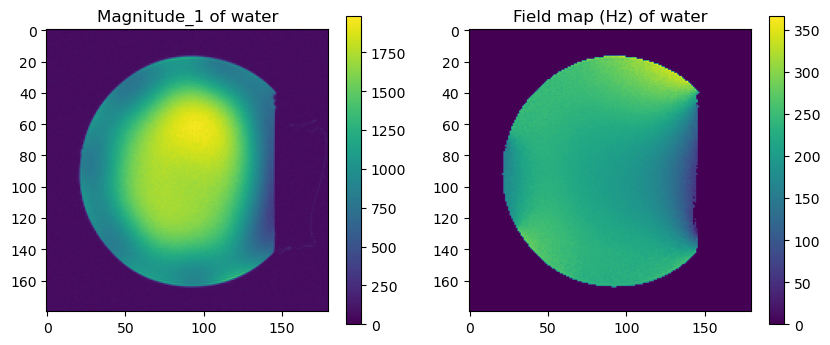

<Figure size 640x480 with 0 Axes>

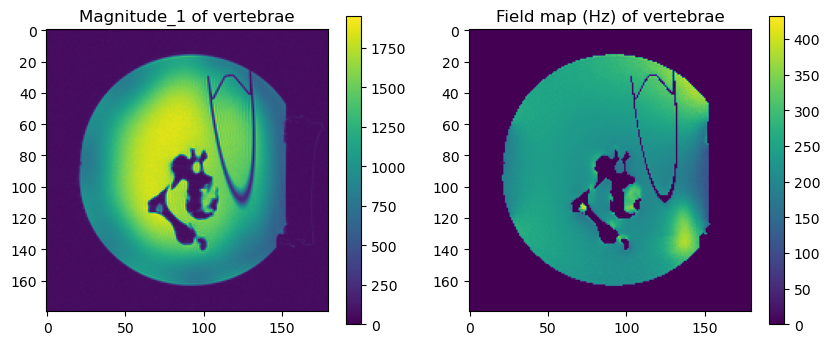

<Figure size 640x480 with 0 Axes>

In [6]:
delta_B_water = rescale(path_mag1_water, path_phase_water, "water", delta_TE, masking=True)
delta_B_vertebrae = rescale(path_mag1_vertebrae, path_phase_vertebrae, "vertebrae", delta_TE, masking=True, slice=85)


In [7]:
########### center of the vertebrae #############

x= 85
y = 107
z_C3 = 95
z_C4 = 77
z_C5 = 55

dx=35
dy=35
dz=35


slice_z = 38
slice_x = 38

##################################################

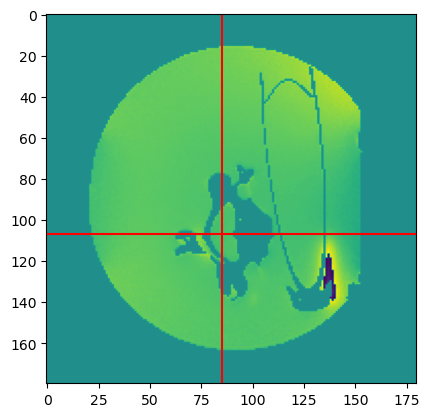

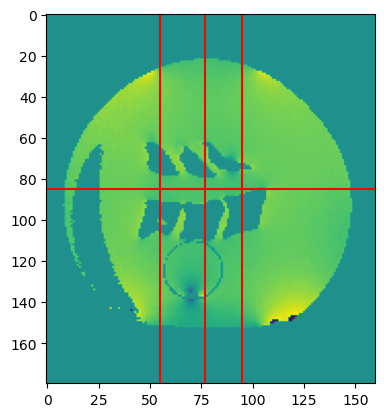

In [8]:
plt.figure()
plt.imshow(delta_B_vertebrae[:,:,80])
plt.axvline(x=x, c="r")
plt.axhline(y=y, c='r')
plt.show()

plt.figure()
plt.imshow(delta_B_vertebrae[y,:,:])
plt.axvline(x=z_C4, c='r')
plt.axvline(x=z_C3, c='r')
plt.axvline(x=z_C5, c='r')

plt.axhline(y=x, c='r')

In [9]:
def rescaling_FOV(field_map, x, y, z, dx=dx, dy=dy, dz=dz):
    '''
    Reshape field_map to a smaller array

    Create a new smaller matrix of volume 2dx*2dy*2dz with values recentered on x,y,z
    Attention: x is the second component and y the first one.

    Parameters
    ----------
    field_map : numpy.ndarray
        3D array pf the FM to reshape.
    x : int
        x coordinate around which field_map will be reshaped
    y : int
        y coordinate around which field_map will be reshaped
    z : int
        z coordinate around which field_map will be reshaped
    dx : int, optional
        0.5*width along the x direction of the reshaped matrix. The default is dx.
    dy : int, optional
        0.5*width along the y direction of the reshaped matrix. The default is dy.
    dz : int, optional
        0.5*width along the z direction of the reshaped matrix. The default is dz.
            
    Returns
    -------
    rescaled_matrix : numpy.ndarray
        Reshaped 3D array.

    '''
    rescaled_matrix= field_map[y-dy:y+dy, x-dx:x+dx, z-dz: z+dz] 
   
    return rescaled_matrix

Create and export the mask of the vertebrae

(180, 180, 160)
(70, 70, 70)


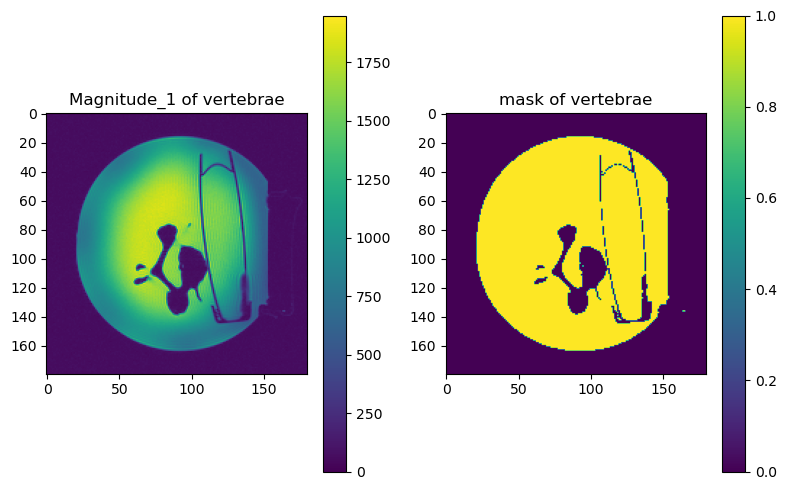

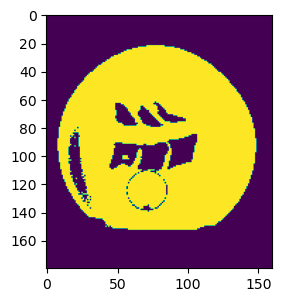

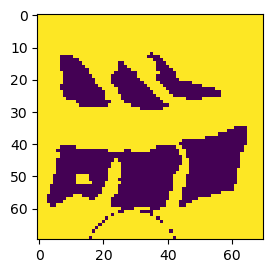

In [10]:
mask_vertebrae = mask(path_mag1_vertebrae, 'vertebrae', 300, plot=True, slice=z_C4)

plt.figure()
plt.subplot(1,2,1)
plt.imshow(mask_vertebrae[y,:,:])

mask_vertebrae_cut = rescaling_FOV(mask_vertebrae, x, y, z_C4, dx=dx, dy=dy, dz=dz)
plt.figure()
plt.subplot(1,2,1)
plt.imshow(mask_vertebrae_cut[dy,:,:])

mdic = {"mask_fm": mask_vertebrae_cut, "label": "mask_vertebrae"}
savemat("matlab_mask_vertebrae.mat", mdic)

print(np.shape(mask_vertebrae))
print(np.shape(mask_vertebrae_cut))

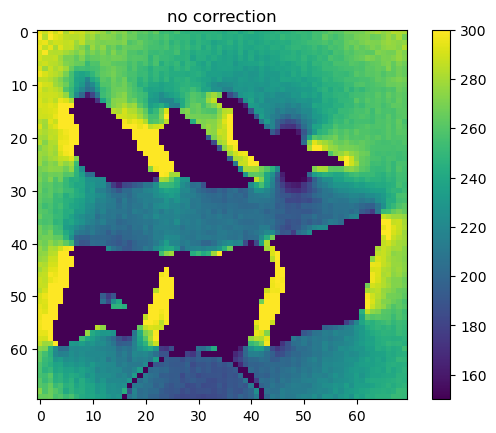

In [11]:
test=rescaling_FOV(delta_B_vertebrae, x, y, z_C4, dx=dx, dy=dy, dz=dz)
plt.figure()
plt.imshow(test[dy,:,:], vmin=150, vmax=300)
plt.title('no correction')
plt.colorbar()


### Correcting the field map with the water background fm

1- correct for the background 

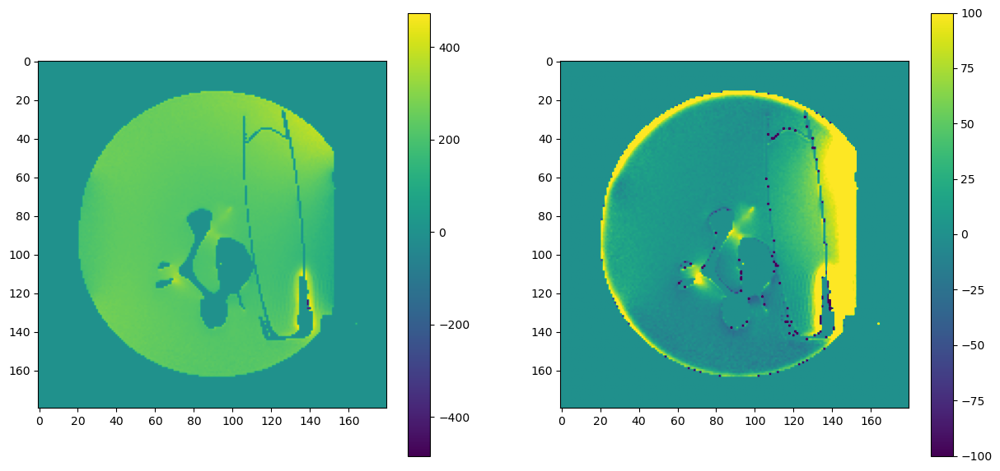

In [12]:
fm_vertebrae= (delta_B_vertebrae - gaussian_filter(delta_B_water, sigma=2))* mask_vertebrae

plt.figure(figsize=(15,7))
plt.subplot(1,2,1)
plt.imshow(delta_B_vertebrae[:,:,z_C4])
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(fm_vertebrae[:,:,z_C4], vmin=-100, vmax=100)
plt.colorbar()

2- recenter 

In [13]:
fm_vertebrae_cut = rescaling_FOV(fm_vertebrae, x, y, z_C4, dx=dx, dy=dy, dz=dz)

avg_backg_cut = np.average(fm_vertebrae_cut, weights = mask_vertebrae_cut)
print(f'The average background of the fm of the vertebrae cut, backgound corrected, is {avg_backg_cut}')
fm_vertebrae_final_cut = (fm_vertebrae_cut - avg_backg_cut)*mask_vertebrae_cut

The average background of the fm of the vertebrae cut, backgound corrected, is 9.344399652070795


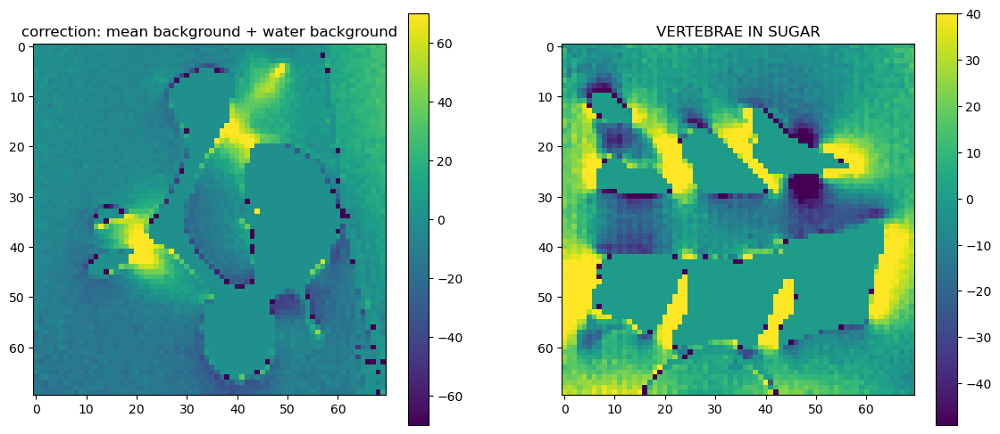

In [14]:
plt.figure(figsize=(14,6))
plt.subplot(121)
plt.imshow(fm_vertebrae_final_cut[:,:,dz], vmin=-70, vmax=70)
plt.title('correction: mean background + water background')
plt.colorbar()
plt.subplot(122)
plt.imshow(fm_vertebrae_final_cut[37,:,:],vmin=-49, vmax=40)
plt.title('VERTEBRAE IN SUGAR')
plt.colorbar()

### import simulations

In [15]:
maskMoi = scipy.io.loadmat(r"I_mask_test5_vertebrae.mat")
simuMoi = scipy.io.loadmat(r"I_sus_simu_test5_vertebrae.mat")

(70, 70, 70)


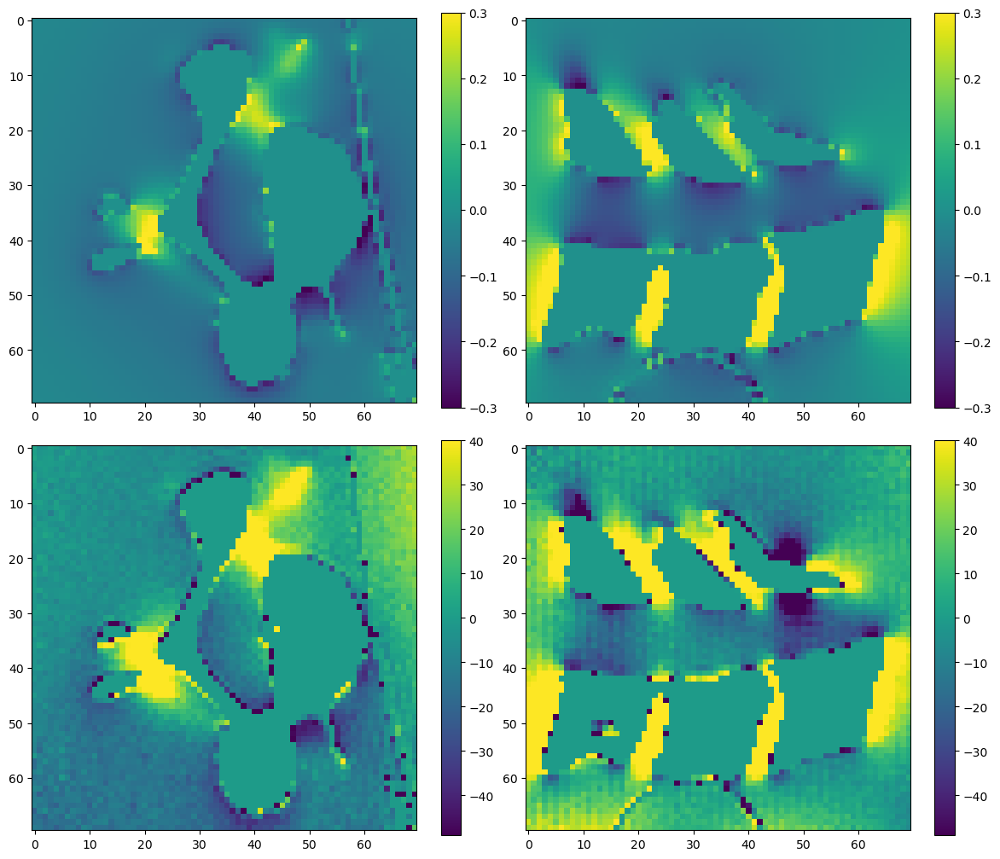

In [16]:
fm_simu_NC = simuMoi['I_sus']
mask_simu = -(maskMoi['I']-1)

fm_simu = fm_simu_NC*mask_simu #put the vertebrae to zero

#######################################################################################################""
fm_simu_final = fm_simu[120:190,120:190,120:190].real
mask_simu_final = mask_simu[120:190,120:190,120:190].real
#######################################################################################################""

print(np.shape(fm_simu_final))

plt.figure(figsize=(12,10))
plt.subplot(2,2,1)
plt.imshow(fm_simu_final[:,:,dz],vmin=-0.3, vmax=0.3)
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(fm_simu_final[dy,:,:],vmin=-0.3, vmax=0.3)
plt.tight_layout()
plt.colorbar()


plt.subplot(2,2,3)
plt.imshow(fm_vertebrae_final_cut[:,:,dz],vmin=-49, vmax=40)
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(fm_vertebrae_final_cut[dy,:,:],vmin=-49, vmax=40)
plt.colorbar()


Check if the simu and expe are aligned:

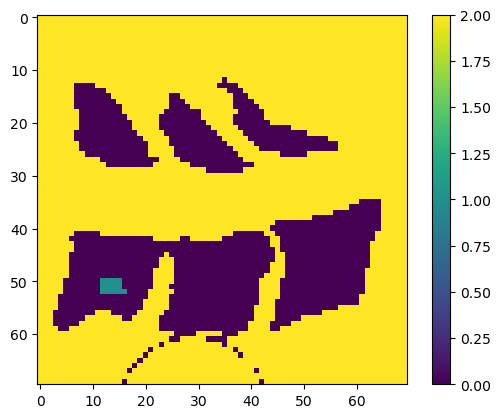

In [17]:
plt.imshow((mask_simu_final+mask_vertebrae_cut)[:,:,dz])
plt.imshow((mask_simu_final+mask_vertebrae_cut)[dy,:,:])
plt.colorbar()

### Comparison between acquired data and simulation on the mask

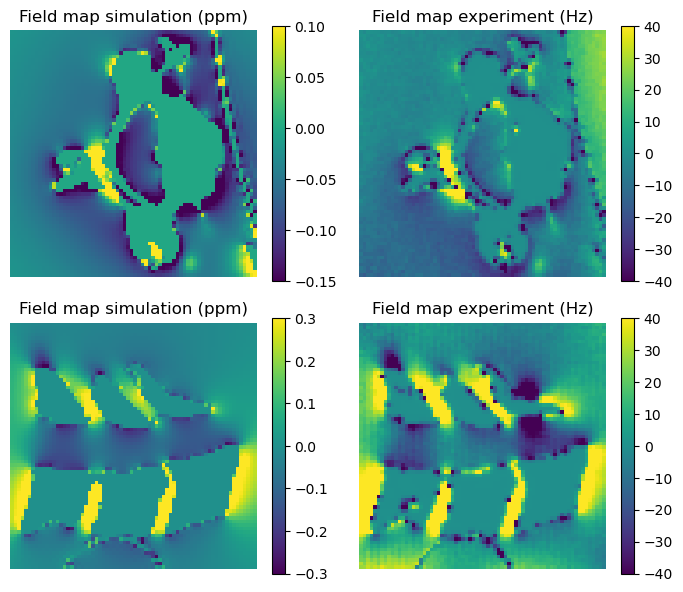

In [18]:
#####################################################
fm_exp_final = gaussian_filter(fm_vertebrae_final_cut, sigma=0.5) #smooth a bit the field map

####################################################


plt.figure(figsize=(7,6))
# ymin, ymax = 0, 75
# xmin, xmax = 0, 78

slice = 35
slice_trans = 38

plt.subplot(2,2,1)
plt.imshow(fm_simu_final[:,:,slice_trans], vmin=-0.15, vmax=0.10) #, aspect='auto')
plt.title('Field map simulation (ppm)')
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(fm_exp_final[:,:,slice_trans], vmin=-40, vmax=40)#, aspect='auto')
plt.title('Field map experiment (Hz)')
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(fm_simu_final[slice,:,:], vmin=-0.3, vmax=0.3) #, aspect='auto')
plt.title('Field map simulation (ppm)')
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin+2,xmax+2)
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(fm_exp_final[slice,:,:], vmin=-40, vmax=40)#, aspect='auto')
plt.title('Field map experiment (Hz)')
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin+2,xmax+2)
plt.colorbar()

plt.tight_layout()
plt.show()
    

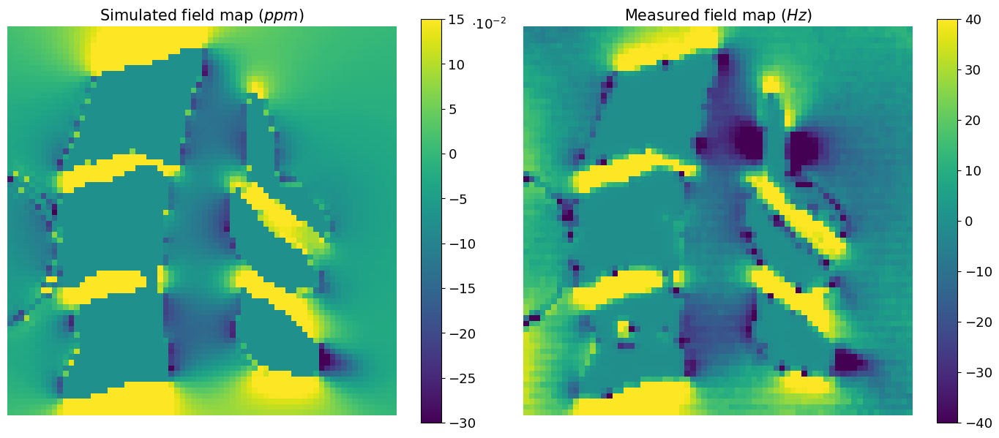

In [19]:
vmin=-30
vmax = 15

mask_offset = -(mask_simu_final-1)*(vmin+vmax)/2
fm_simu_final_x100_off = fm_simu_final*100+mask_offset # this is just to change the value inside the vertebrae
fm_simu_final_x100 = fm_simu_final*100



fig=plt.figure(figsize=(14,6))
fig.patch.set_facecolor('white')
# ymin, ymax = 0, 75
# xmin, xmax = 0, 78

slice = 34

plt.subplot(1,2,1)
plt.imshow(np.transpose(fm_simu_final_x100_off[slice,::-1,::-1]), vmin=vmin, vmax=vmax) #, aspect='auto')
plt.title('Simulated field map ($ppm$)', size=15)
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x=83, y=0, s='$\cdot 10^{-2}$', size=13)

plt.subplot(1,2,2)
plt.imshow(np.transpose(fm_exp_final[slice,::-1,::-1]), vmin=-40, vmax=40)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
# plt.ylim(ymax,ymin)
plt.axis('off')
# plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)


plt.tight_layout()
# plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)
tikzplotlib.save(r"figures\field_maps_ppm_hz.pgf")

#### letters
#plt.text(x= -107.5 ,y=3, s='a)', size=15)
#plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
plt.show()



In [20]:
def linear_reg_simexp(fm_simu1, fm_exp1, mask_simu1, mask_exp1, part, xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_simu)[1], ymax=np.shape(fm_simu)[0], zmax=np.shape(fm_simu)[2]):
    '''
    Calculate the linear regression between `fm_simu1` and `fm_exp1`, excluding the values inside the masks (inside the compound).

    
    The regression between fm_simu1 and fm_exp1 is calculated on the voxels which coordinates are inside [xmin,xmax],[ymin,ymax],[zmin,zmax]
    Attention: x is the second component and y the first one.
    Plot the linear regression, one slice of the simulated and acquired field map and the histogram of the error. 
    
    Parameters
    ----------
    fm_simu1 : np.ndarray
        3D array of the simulated FM.
    fm_exp1 : np.ndarray
        3D array of the acquired FM.
    mask_simu1 : np.ndarray
        3D array of the simulated mask.
    mask_exp1 : np.ndarray
        3D array of the acquired mask.
    part : str
        description of the compound.
    xmin : int, optional
        the minimum x value to use for the regression calculation. The default is 0.
    ymin : int, optional
        the minimum y value to use for the regression calculation. The default is 0.
    zmin : int, optional
        the minimum z value to use for the regression calculation. The default is 0.
    xmax : int, optional
        the maximum x value to use for the regression calculation. The default is np.shape(fm_simu)[1].
    ymax : int, optional
        the maximum y value to use for the regression calculation. The default is nnp.shape(fm_simu)[0].
    zmax : int, optional
        the maximum z value to use for the regression calculation. The default is np.shape(fm_simu)[2].

    Returns
    -------
    result_corrected : scipy.stats._stats_mstats_common.LinregressResult
        A tuple containing the parameters of the regression line.

    '''
    ### reshaping to 1D vector
    
    fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    fm_exp=fm_exp1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_simu2=mask_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_exp2=mask_exp1[ymin:ymax, xmin:xmax, zmin:zmax]

    m,n,p = fm_simu.shape
    simu = fm_simu.reshape(m*n*p) #need to have vector 1D to apply the linear regression
    exp = fm_exp.reshape(n*m*p)

    mask_exp = mask_exp2.reshape(m*n*p)
    mask_simu = mask_simu2.reshape(m*n*p)

    exp_corrected = []
    simu_corrected=[]

    for i in range(m*p*n):
        if mask_exp[i]!=0 and mask_simu[i]!=0:
            simu_corrected.append(simu[i])
            exp_corrected.append(exp[i])

    ### regression lineaire
    result_corrected = scipy.stats.linregress(simu_corrected, exp_corrected)
    print(f'######## regression linéaire - {part} ############')
    print(f' fm_exp = {result_corrected.slope} * fm_simu + {result_corrected.intercept} ')
    print(f'R^2 = {result_corrected.rvalue **2}')
    print(f'p-value = {result_corrected.pvalue }')


    #######################"" plot################################
    plt.figure()
    plt.plot(simu_corrected, exp_corrected, '.', c='pink', label=part)
    plt.xlabel('Simulation')
    plt.ylabel('Experience')
    plt.title(f'Correlation between simulation and experience on {part}')
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'b')
    plt.legend()
    plt.show()

    
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(fm_simu[int((ymax-ymin)/2),:, :])
    plt.subplot(1,2,2)
    plt.imshow(fm_simu[:,:, int((zmax-zmin)/2)])
    plt.show()

    
    plt.figure() ## histogram of the error
    approx = np.array([result_corrected.intercept + result_corrected.slope*simu_corrected[i] for i in range(len(simu_corrected))])
    error = exp_corrected - approx #f(xi)-y
#     plt.plot(simu_corrected, error)    
    plt.hist(error, bins=75)
    plt.title('Histogram of the error f(xi)-y')
    plt.show()
    
    print(np.shape(fm_simu))
    return result_corrected

######## regression linéaire - whole array ############
 fm_exp = 151.20289544332783 * fm_simu + 2.679219178307266 
R^2 = 0.4235756640484316
p-value = 0.0


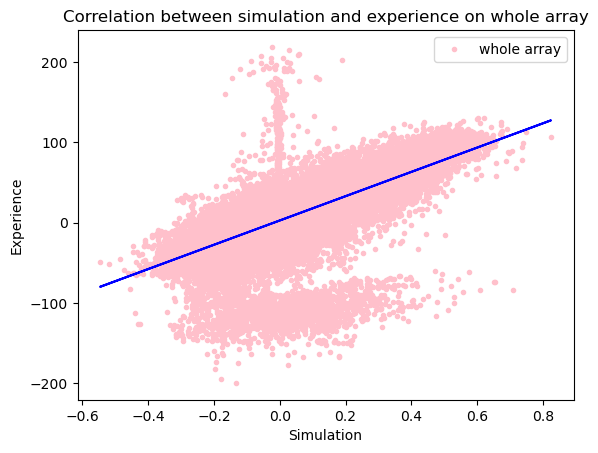

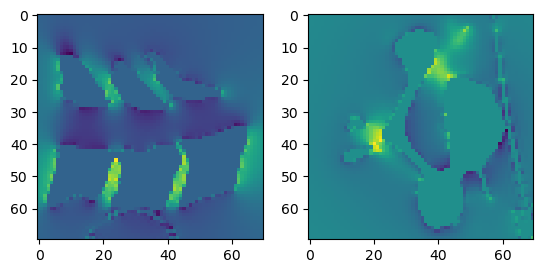

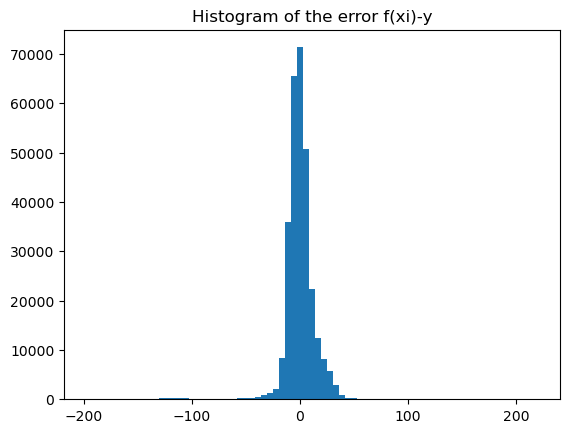

(70, 70, 70)


In [21]:
result_wholearray = linear_reg_simexp(fm_simu1=fm_simu_final, fm_exp1=fm_exp_final, mask_simu1=mask_simu_final, mask_exp1=mask_vertebrae_cut, part="whole array", xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_simu_final)[1], ymax=np.shape(fm_simu_final)[0], zmax=np.shape(fm_simu_final)[2])


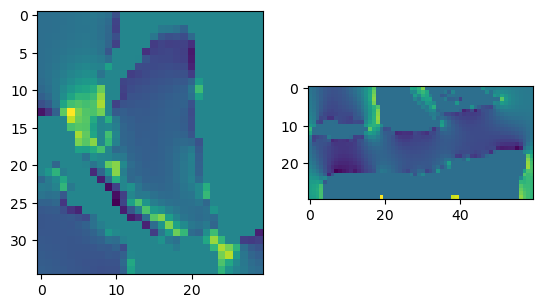

In [22]:
xcmin = 20
xcmax =50
ycmin = 20
ycmax = 55
zcmin = 5
zcmax =65
plt.figure()
plt.subplot(1,2,1)
plt.imshow(fm_simu_final[ycmin:ycmax, xcmin:xcmax, 40])
plt.subplot(1,2,2)
plt.imshow(fm_simu_final[40, xcmin:xcmax, zcmin:zcmax])

######## regression linéaire - spinal canal ############
 fm_exp = 162.17090901584632 * fm_simu + 2.114771855958572 
R^2 = 0.5197823893665788
p-value = 0.0


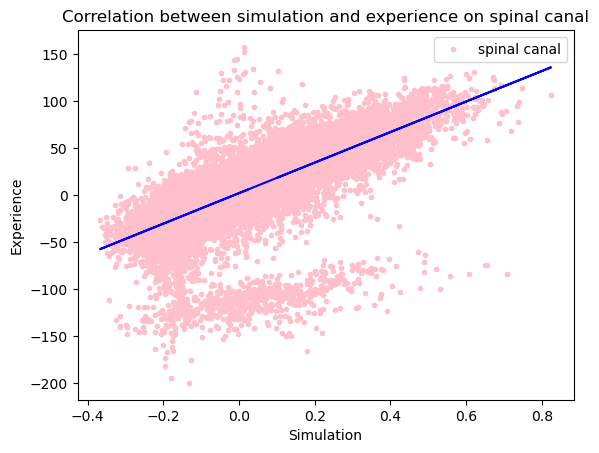

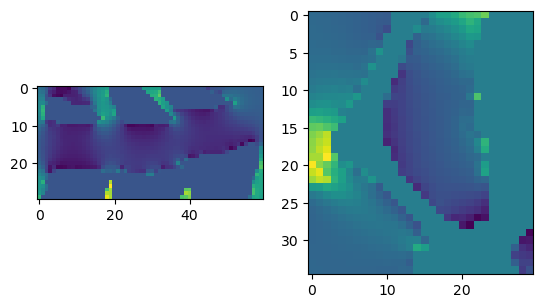

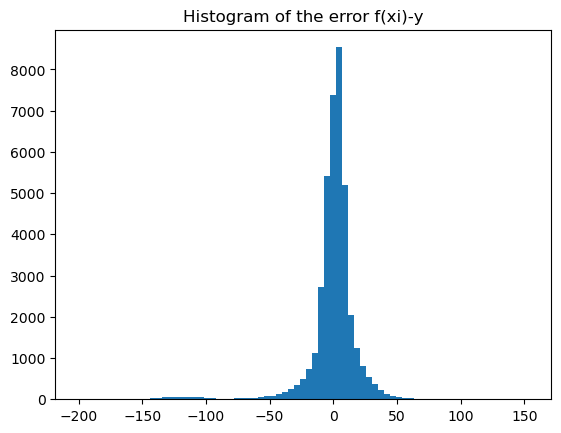

(35, 30, 60)


In [23]:
result_canal = linear_reg_simexp(fm_simu1=fm_simu_final, fm_exp1=fm_exp_final, mask_simu1=mask_simu_final, mask_exp1=mask_vertebrae_cut, part="spinal canal", xmin=xcmin, ymin=ycmin, zmin=zcmin, xmax=xcmax, ymax=ycmax, zmax=zcmax)


### Correction of the simu

In [24]:
fm_simu_final_corrected = fm_simu_final*162

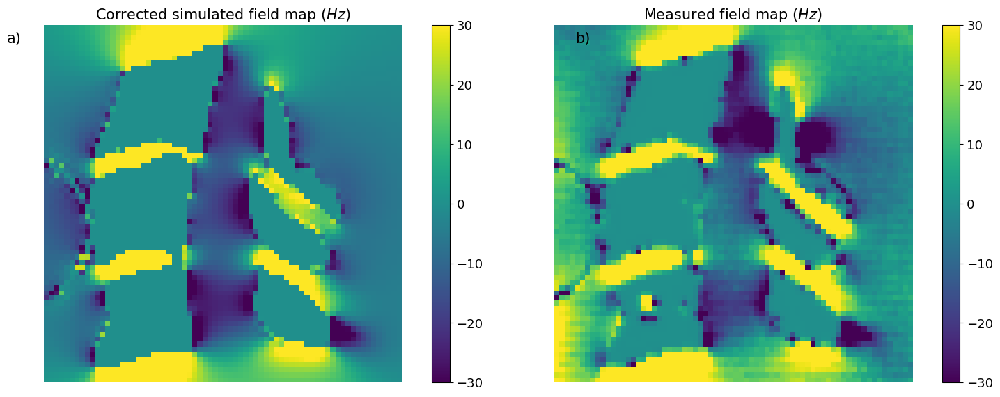

In [25]:
fig=plt.figure(figsize=(14,6))
fig.patch.set_facecolor('white')

slice = 34

plt.subplot(1,2,1)
plt.imshow(np.transpose(fm_simu_final_corrected[slice,::-1,::-1]), vmin=-30, vmax=30)#, aspect='auto')
plt.title('Corrected simulated field map ($Hz$)', size=15)
plt.axis('off')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)

plt.subplot(1,2,2)
plt.imshow(np.transpose(fm_exp_final[slice,::-1,::-1]), vmin=-30, vmax=30)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
plt.axis('off')
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)


plt.tight_layout()
plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)

#### letters
plt.text(x= -107.5 ,y=3, s='a)', size=15)
plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
plt.show()
    

## II. Multiecho

In [26]:
path_12TE = [f"JOHANNA_BRUNNHILDE_20230224\GRE_0_3MM_12TE_SUGAR_0026\GRE_0_3MM_12TE_SUGAR_0026_GRE_0.3mm_12TE_sugar_20230224095347_26_e{i}.nii.gz" for i in range(1,13) ]

(600, 576, 25)


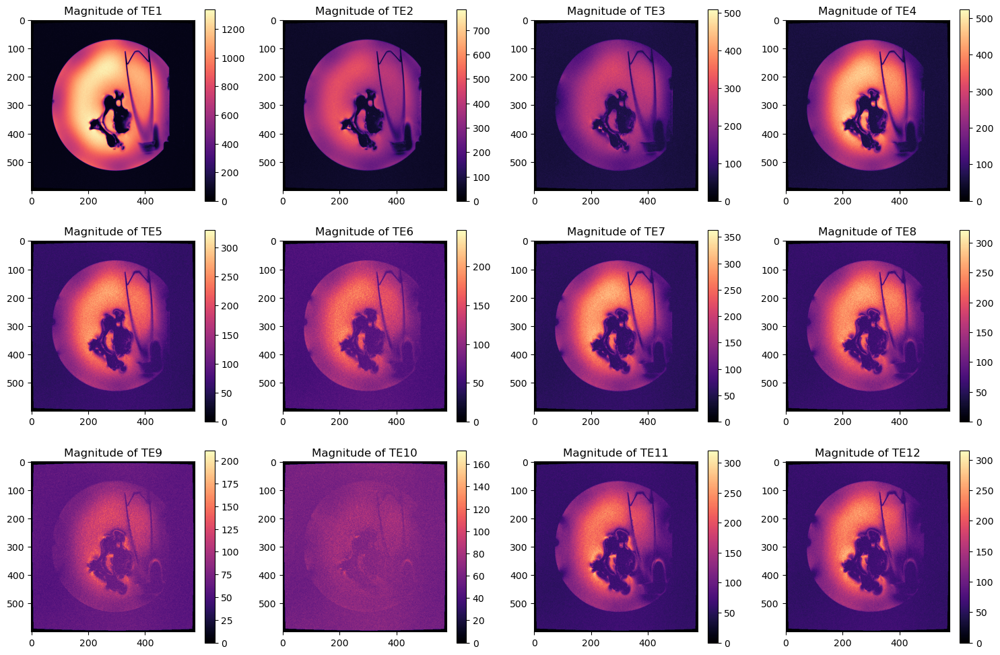

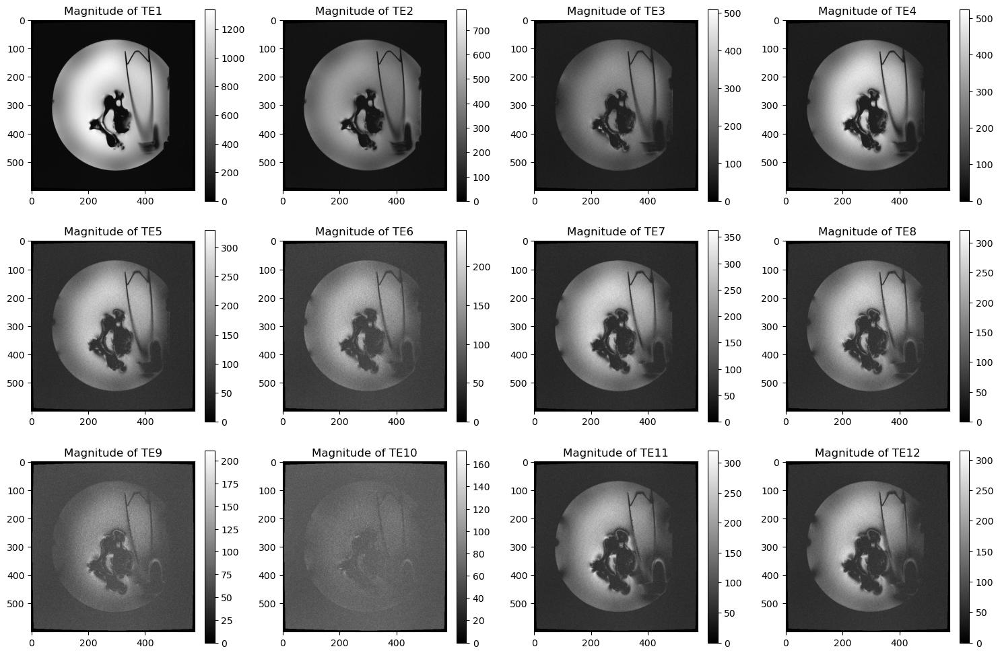

In [27]:
mag_12TE = [nib.load(path_12TE[i]).get_fdata() for i in range(12)]

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE[i][:,:,13] , cmap='magma')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

print(np.shape(mag_12TE[0]))
plt.show()

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE[i][:,:,13] , cmap='gray')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()


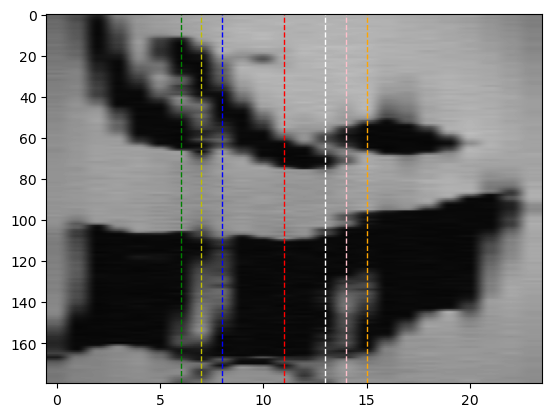

In [28]:
mag_rescaled = rescaling_FOV(mag_12TE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12)
plt.imshow(mag_rescaled[100,:,:] , cmap='gray', vmin=0, vmax=1800, aspect='auto')
#plt.imshow(mag_rescaled[:,:,12] , vmin=0, vmax=1800, aspect='auto')

plt.axvline(x=11,color='r',linestyle='--', linewidth=1)
plt.axvline(x=6,color='g',linestyle='--', linewidth=1)
plt.axvline(x=7,color='y',linestyle='--', linewidth=1)
plt.axvline(x=8,color='b',linestyle='--', linewidth=1)
plt.axvline(x=13,color='w',linestyle='--', linewidth=1)
plt.axvline(x=14,color='pink',linestyle='--', linewidth=1)
plt.axvline(x=15,color='orange',linestyle='--', linewidth=1)
plt.show()

In [29]:
def multiTE_plot(x, mag_multiTE = mag_12TE, color='gray'):
    """
    Plot one transversal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    x : int
        x-coordinate of the slices to display
    mag_multiTE : list, optimal
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=275, y=350, z=12, dx=90, dy=110, dz=12)      
        im = ax.imshow(mag_rescaled[:,:,x], cmap=color,vmin=-10, vmax=300)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)
    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    M1 = rescaling_FOV(mag_multiTE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12)      

    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c],x=275, y=350, z=12, dx=90, dy=110, dz=12)      
        im = ax.imshow((M1[:,:,x]-mag_rescaled[:,:,x]), vmin=-0, vmax=1400)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

In [30]:
def multiTE_plot_longi(y, mag_multiTE = mag_12TE, color='gray'):
    """
    Plot one longitudinal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    y : int
        y-coordinate of the slices to display
    mag_multiTE : list, optimal
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=275, y=350, z=12, dx=90, dy=110, dz=12)        
        im = ax.imshow(mag_rescaled[y,:,:], cmap=color, aspect='auto',vmin=-10, vmax=300)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    M1=rescaling_FOV(mag_12TE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12)
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=275, y=350, z=12, dx=90, dy=110, dz=12)        
        im = ax.imshow(M1[y,:,:]-mag_rescaled[y,:,:],  aspect='auto',vmin=-0, vmax=1400)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

############# TE1 to TE12 for a slice in the top C5 (green) ################


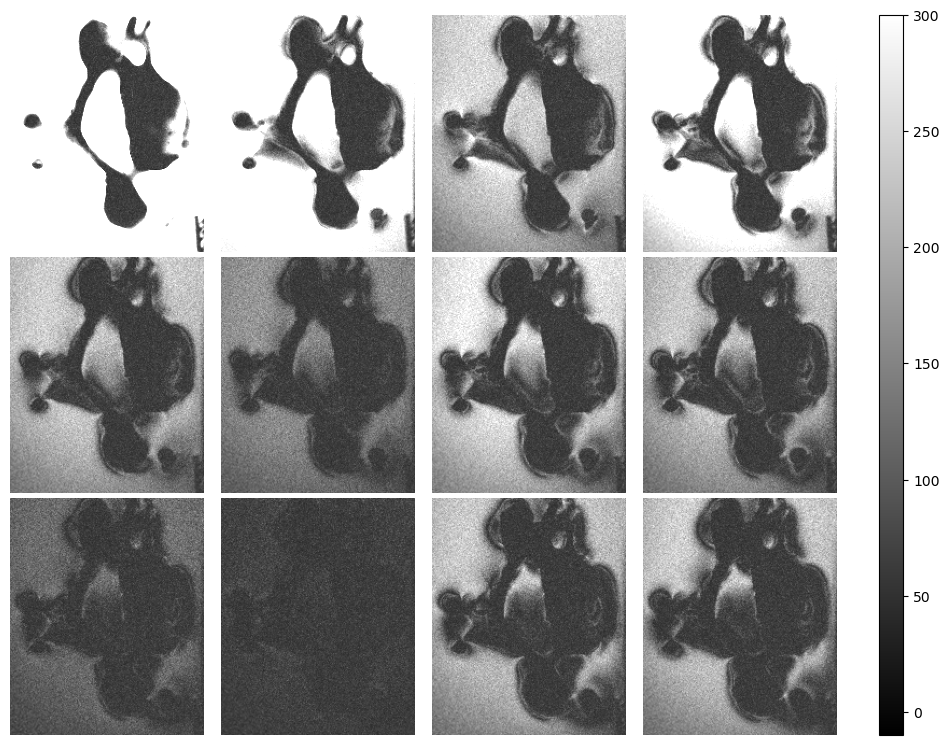

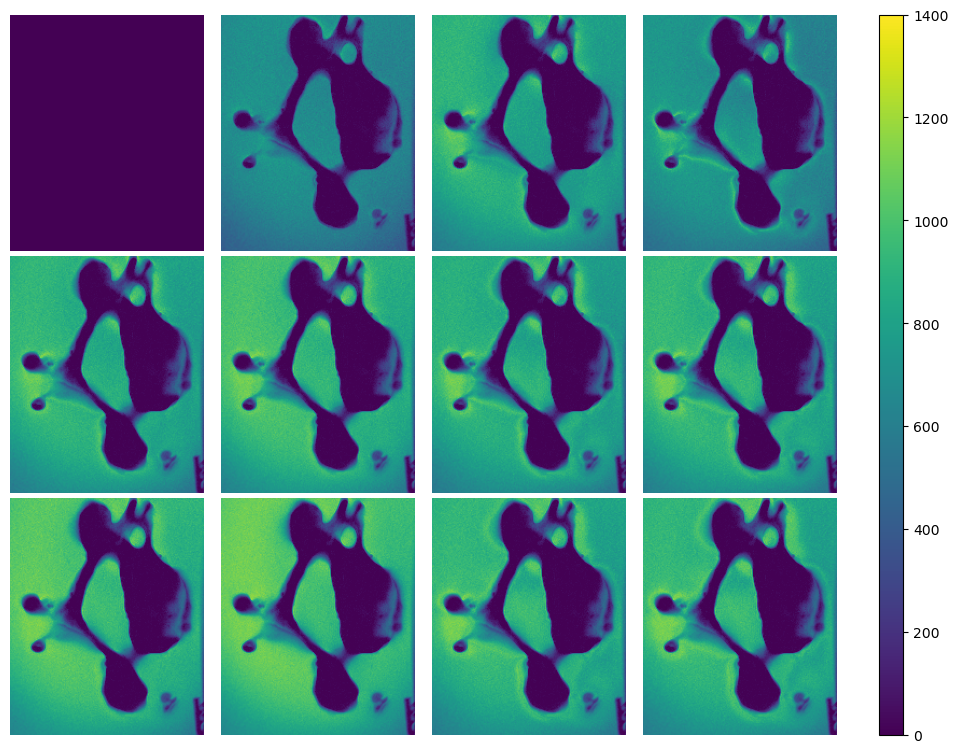

In [31]:
print('############# TE1 to TE12 for a slice in the top C5 (green) ################')
multiTE_plot(6, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################


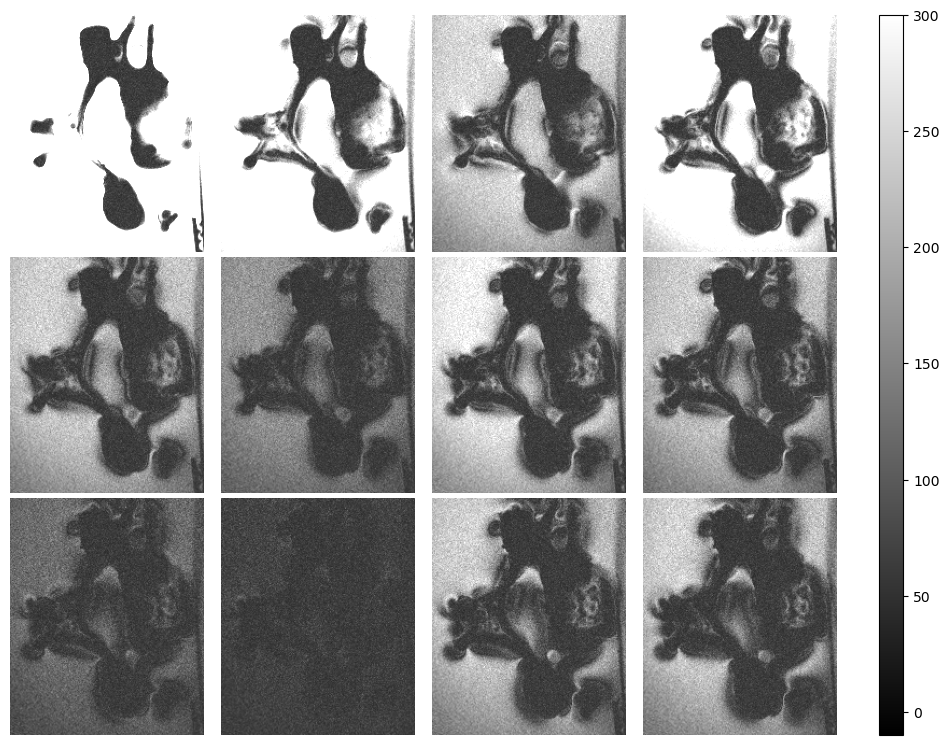

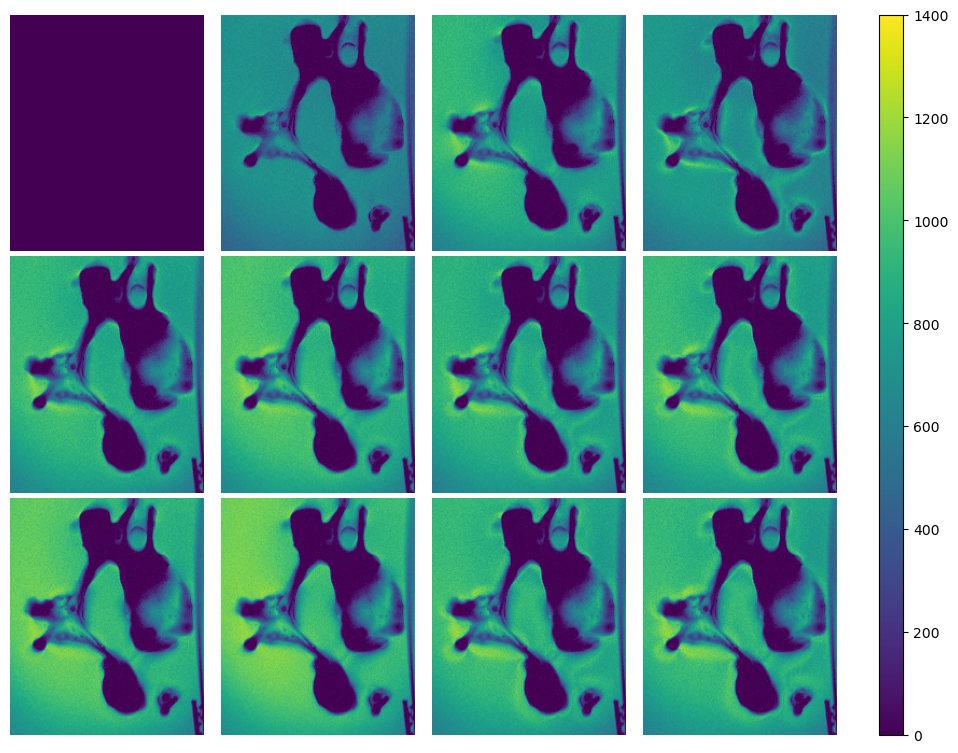

In [32]:
print('############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################')
multiTE_plot(7, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################


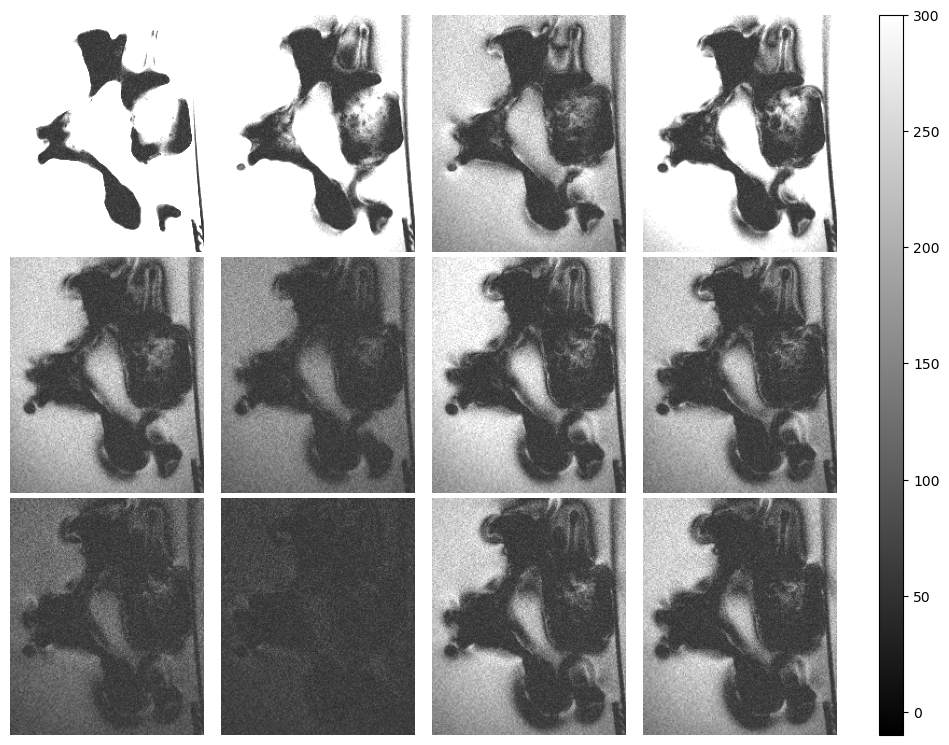

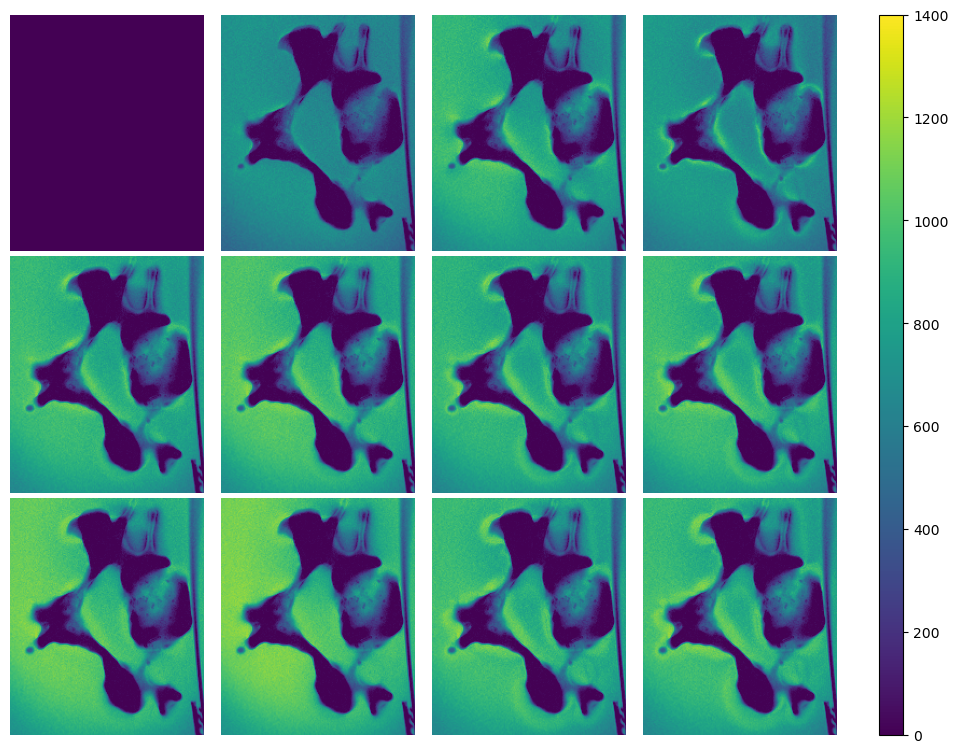

In [33]:
print('############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################')
multiTE_plot(8, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the middle of C4 (red) ################


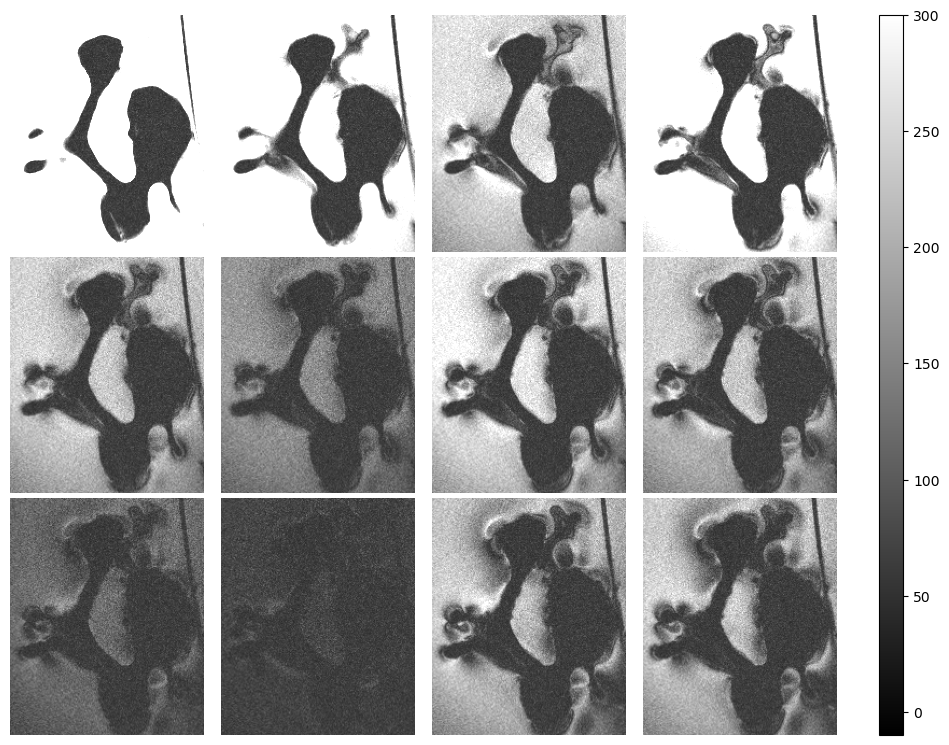

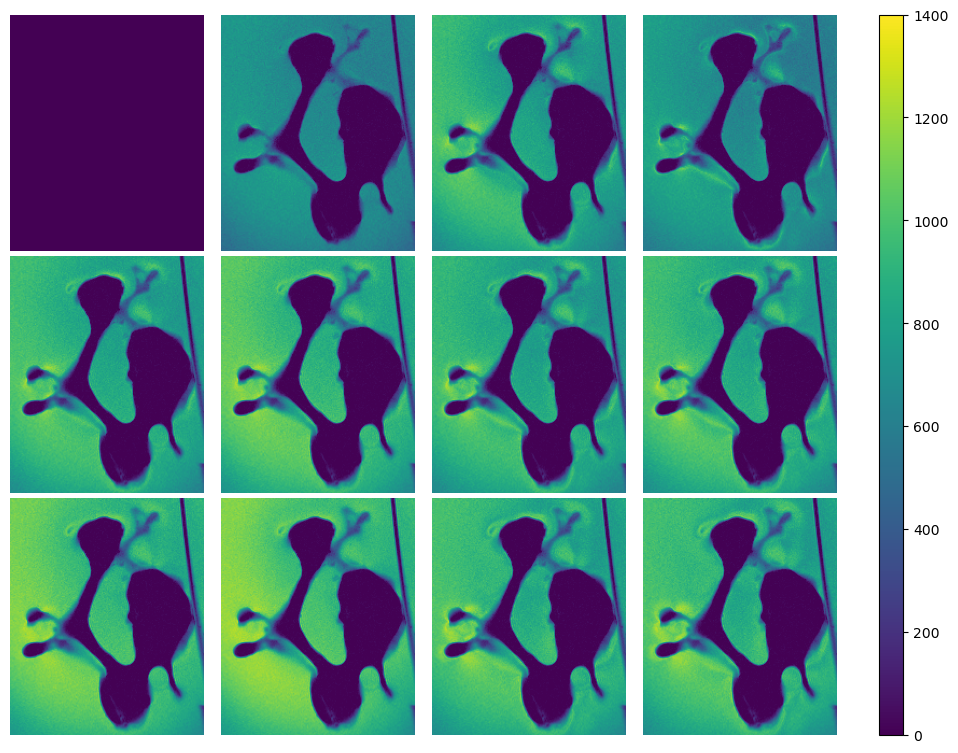

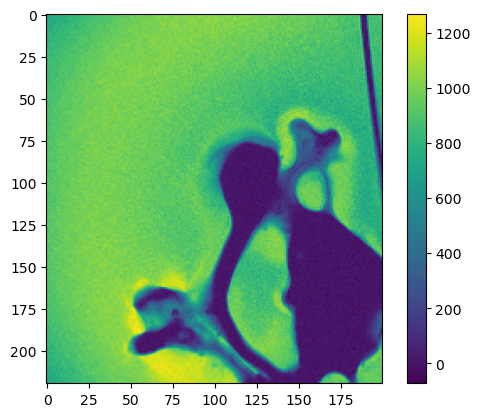

In [34]:
print('############# TE1 to TE12 for a slice in the middle of C4 (red) ################')
multiTE_plot(11, mag_multiTE = mag_12TE)

M1=rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)
M12=rescaling_FOV(mag_12TE[11], x=250, y=294, z=13, dx=100, dy=110, dz=12)

plt.imshow(M1[:,:,11]-M12[:,:,11])
plt.colorbar()

############# TE1 to TE12 for a slice in the top C4 (white) ################


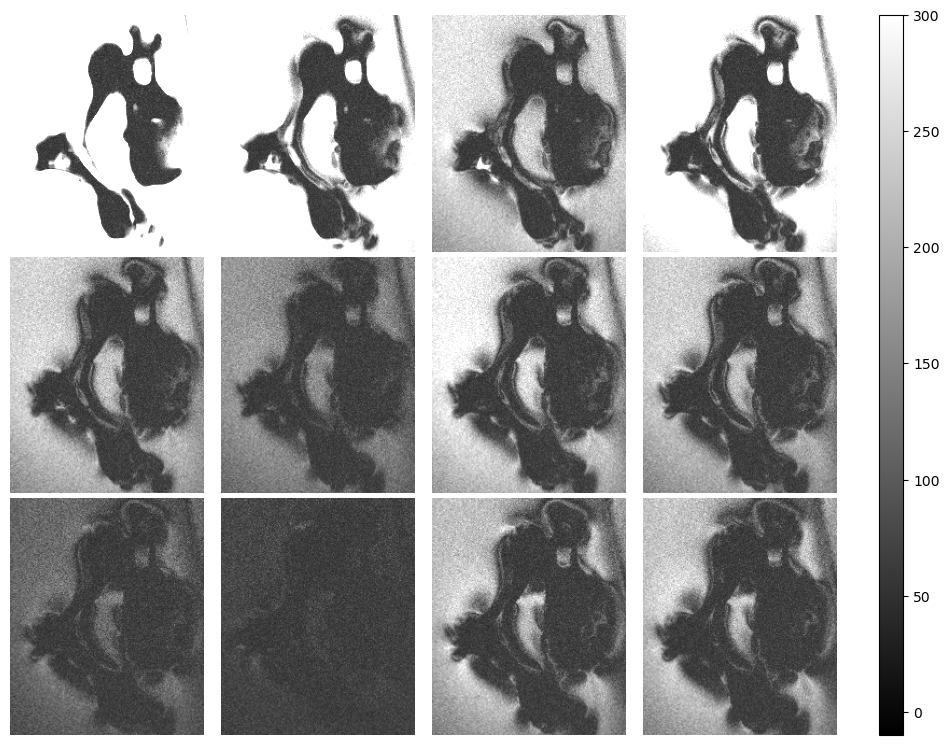

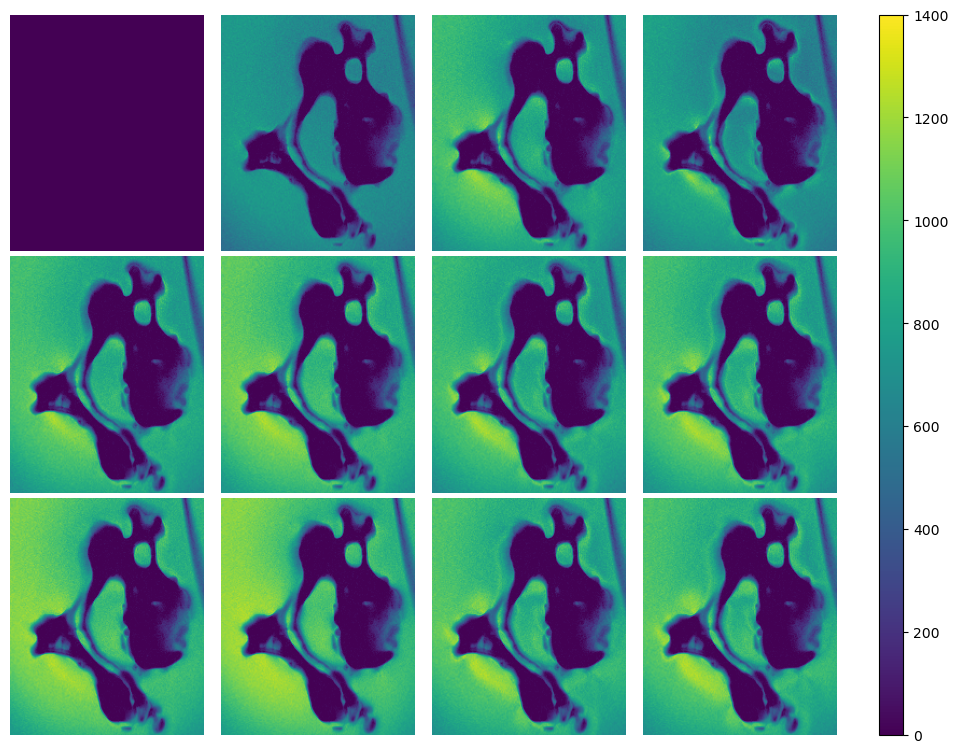

In [35]:
print('############# TE1 to TE12 for a slice in the top C4 (white) ################')
multiTE_plot(13, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice between C4 and C3 (pink) ################


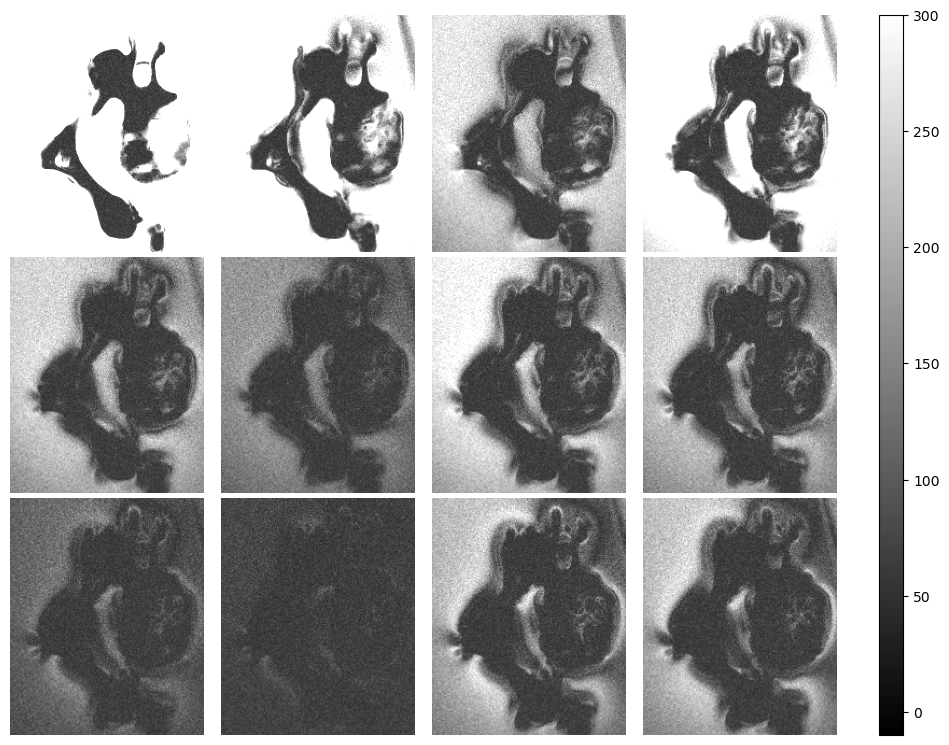

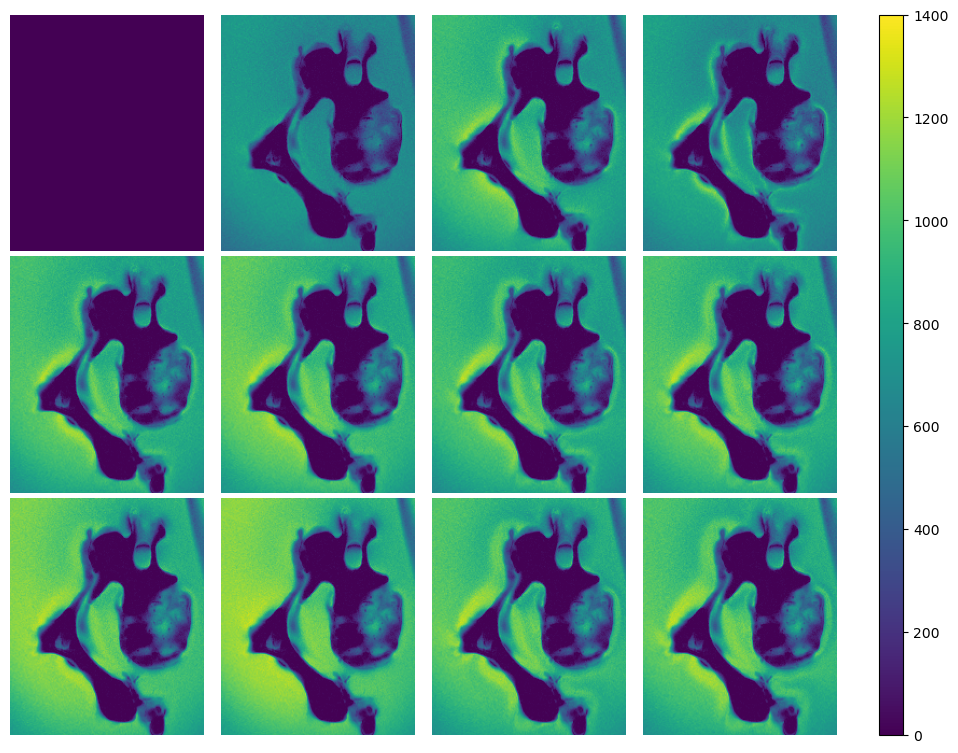

In [36]:
print('############# TE1 to TE12 for a slice between C4 and C3 (pink) ################')
multiTE_plot(14, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the bottom C3 (orange) ################


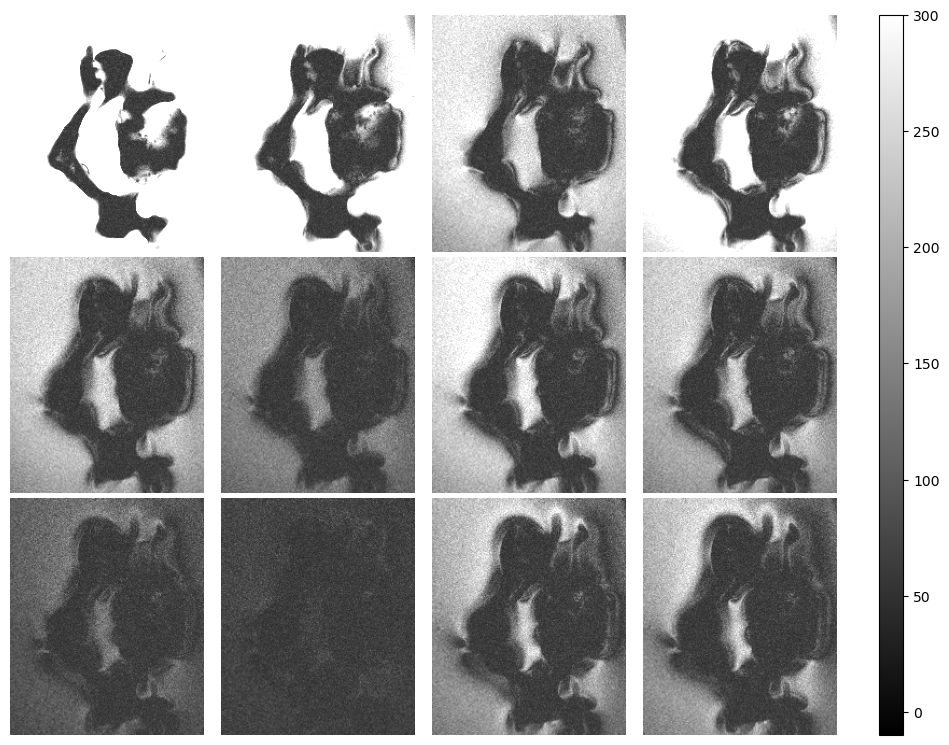

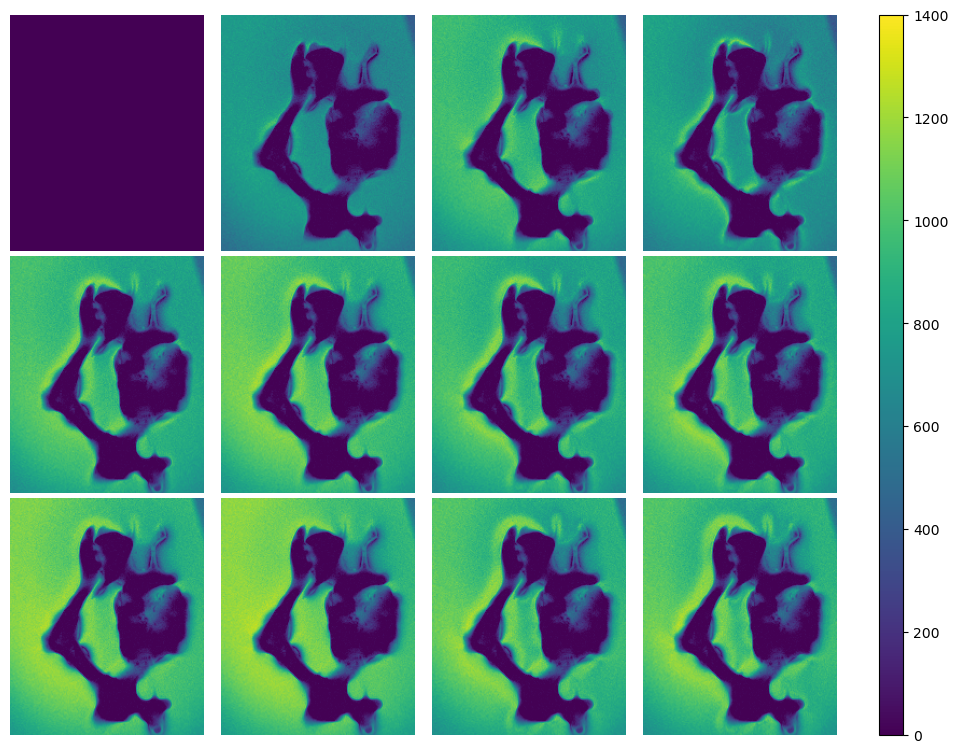

In [37]:
print('############# TE1 to TE12 for a slice in the bottom C3 (orange) ################')
multiTE_plot(15, mag_multiTE = mag_12TE)

############# TE1 to TE12 for longitudinaly ################


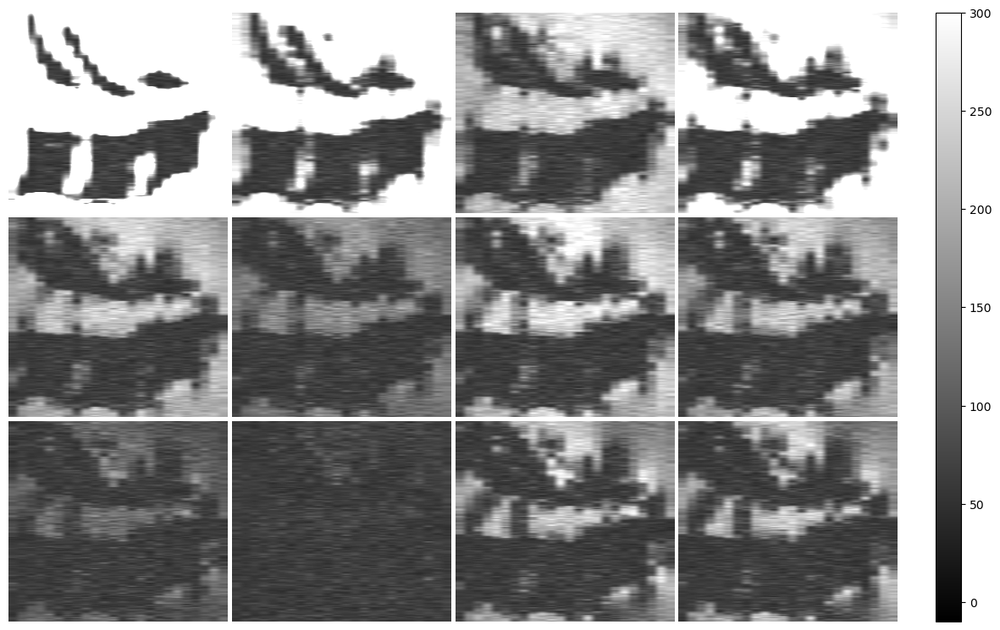

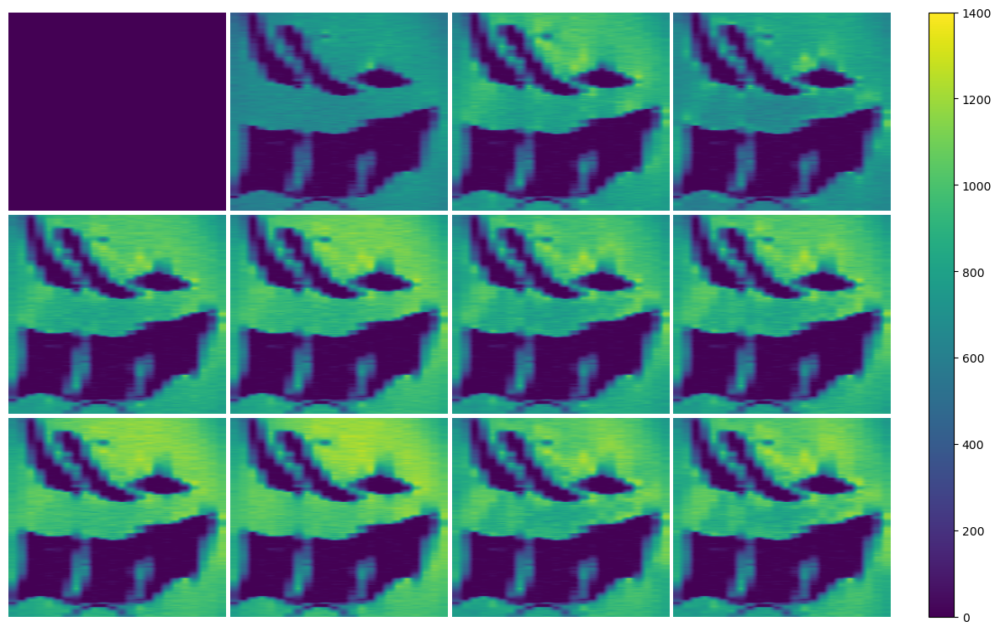

In [38]:
print('############# TE1 to TE12 for longitudinaly ################')
multiTE_plot_longi(100, mag_multiTE = mag_12TE)

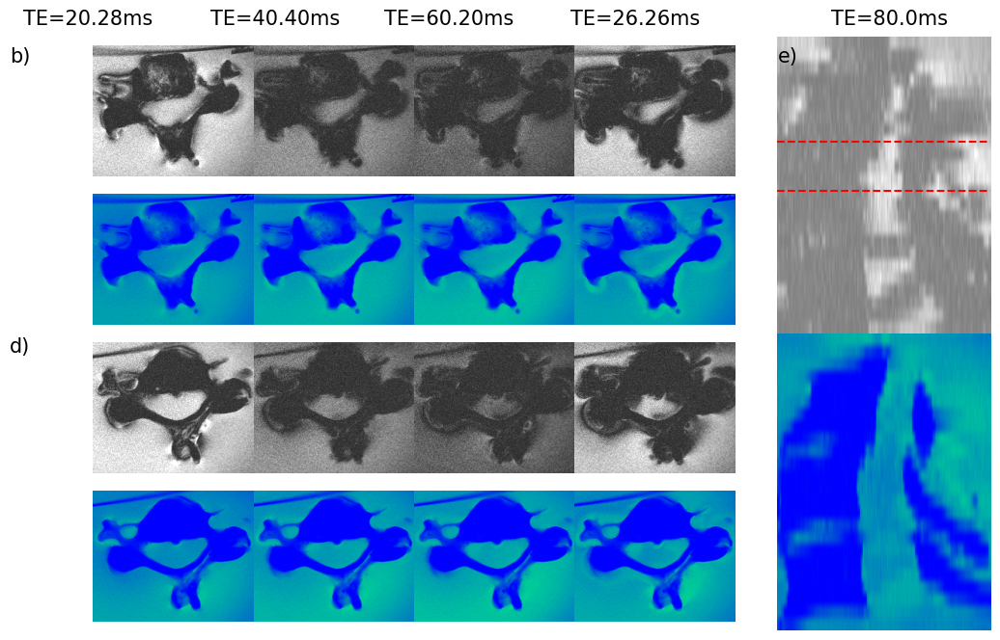

In [39]:
fig = plt.figure(figsize=(12,8))
fig.patch.set_facecolor('white')

gs0 = GridSpec(1, 2, figure=fig, width_ratios=[0.75,0.25],wspace=0.1)

gs00 = gridspec.GridSpecFromSubplotSpec(4, 4, subplot_spec=gs0[0], wspace=0, hspace=0) #left

def plot_2lines(z, ligne):
    for i in range(4): # first line --> echos 3-6-9-12 
        ax = fig.add_subplot(gs00[ligne-1, i])
        mag = rescaling_FOV(mag_12TE[2+3*i], x=275, y=350, z=12, dx=90, dy=110, dz=12)
        ax.imshow(np.transpose(mag[:,::-1,z], (1,0)), cmap='gray',vmin=-0, vmax=300)
        ax.axis('off')

    M1 = rescaling_FOV(mag_12TE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12) #second line --> differnece with first echo line
    for i in range(4):
        ax = fig.add_subplot(gs00[ligne, i])
        mag = rescaling_FOV(mag_12TE[2+3*i], x=275, y=350, z=12, dx=90, dy=110, dz=12)
        diff = M1-mag
        ax.imshow(np.transpose(diff[:,::-1,z], (1,0)),vmin=-0, vmax=1500, cmap='winter')
        ax.axis('off')
        

plot_2lines(8,1) #plot green
plot_2lines(12, 3) #plot red 
    
#################################################################################################
gs01 = gs0[1].subgridspec(2, 1,wspace=0, hspace=0) # right
y=100

ax = fig.add_subplot(gs01[0])
mag = rescaling_FOV(mag_12TE[11], x=275, y=350, z=12, dx=90, dy=110, dz=12) 
magsplit = mag[:,::-1,::-1]
ax.imshow(np.transpose(magsplit[y,10:-10,:]), cmap='gray', aspect='auto',vmin=-200, vmax=300)
ax.axis('off')
ax.axhline(y=12,color='r',linestyle='--', linewidth=1.5)
ax.axhline(y=8,color='r',linestyle='--', linewidth=1.5)
M1=rescaling_FOV(mag_12TE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12)
diff = M1-mag

ax = fig.add_subplot(gs01[1])
mag = rescaling_FOV(mag_12TE[11], x=275, y=350, z=12, dx=90, dy=110, dz=12) 
diffsplit = diff[:,::-1,::-1]
ax.imshow(np.transpose(diffsplit[y,10:-10,:]), aspect='auto',vmin=-0, vmax=1600, cmap='winter')
ax.axis('off')


#### letter
plt.text(x= -575 ,y=-22.5, s='b)', size=15)
plt.text(x= -0 ,y=-22.5, s='e)', size=15)
plt.text(x= -575 ,y=1, s='d)', size=15)
plt.text(x= -565 ,y=-25.5, s='TE=20.28ms', size=15)
plt.text(x= -425 ,y=-25.5, s='TE=40.40ms', size=15)
plt.text(x= -295 ,y=-25.5, s='TE=60.20ms', size=15)
plt.text(x= -155 ,y=-25.5, s='TE=26.26ms', size=15)
plt.text(x= 40 ,y=-25.5, s='TE=80.0ms', size=15)
# plt.text(x= -680 ,y=-25.5, s='TE=26.26ms', size=16)

#plt.savefig(r"multiecho.png")


# plt.tight_layout()
# plt.suptitle("Multiecho")
plt.show()


## Comparison signal loss by multiecho - z-gradient

We want to compare the loss obtained with the two differnet acquisitions

In [40]:
print("Header fm:")

header_fm = nib.load(path_mag1_vertebrae).header
print(header_fm)



print("#################################################################################################")
print("Header multiecho:")

header_12TE = [nib.load(path_12TE[i]).header for i in range(12)]
print(header_12TE[0])


Header fm:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 57
dim             : [  3 180 180 160   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [-1.    1.    1.    1.    1.05  0.    0.    0.  ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'TE=3.1;Time=124713.712;phase=1'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.0
quatern_c       : 1.0
quatern_d       : 0.0
qoffset_x       : 90.60241
qoffset_y       : -93.819275

#### Lets try to find the exact positions:
Using the header we have:
$z_{ME} = 3*k_{ME}-37.2$ and $z_{fm} = 1*k_{fm}-80.70$.

So after reshaping like we did before, we got that the first ME slice has a z-position of -37.2, while the first of the rotated fm has a z-position of -80.70+z_C4-dz = -38.7.

Finally we can see that, in our final matrixes: $slice_{fm} = 3*slice_{ME}+1.5$ 

Compute the signal loss from the FM:

In [41]:
m,n,p = np.shape(fm_exp_final)
signal_loss_fm= np.zeros((m,n,p))

for i in tqdm.tqdm(range(m)):
    for j in range(n):
        for k in range(1,p-1):
            Z=np.array([fm_exp_final[i,j ,k-1],fm_exp_final[i,j,k],fm_exp_final[i,j,k+1]])
            X=np.array([1,2,3]) #because there is a difference of 1mm between each voxel
            lin = scipy.stats.linregress(X, Z) # a linear regression to get the slope 
            slope =lin.slope
            signal_loss_fm[i,j,k]=slope

100%|██████████████████████████████████████████████████████████████████████████████████| 70/70 [00:13<00:00,  5.01it/s]


In [42]:
def signal_loss_comp(sliceME, sigma=0.5):
    """
    Plot the comparison of the two signal losses for the same aligned slice

    Parameters
    ----------
    sliceME : int
        coordinate of the trasnversal slice we want to display
    sigma : float, optional
        Standard deviation of the Gaussian smoothing of the FM's signal loss

    Returns
    -------
    None
        
    """
    M1 = rescaling_FOV(mag_12TE[0], x=275, y=350, z=12, dx=90, dy=110, dz=12)      
    M12 = rescaling_FOV(mag_12TE[11], x=275, y=350, z=12, dx=90, dy=110, dz=12) 
    signal_loss_multi = (M1-M12)[::-1,::-1,:]

    signal_loss_fm_final = abs(gaussian_filter(signal_loss_fm, sigma=sigma))


    #signal loss comparison
    slice_fm = sliceME*3+1 # OR +2

    plt.figure(figsize=(10,4))
    plt.subplot(121)
    plt.imshow(signal_loss_fm_final[dy,:,:], vmin=-0, vmax=6)
    plt.axvline(x=slice_fm-6, c="r")
    plt.subplot(122)
    plt.imshow(signal_loss_multi[108,:,:],vmin=-30, vmax=300, aspect="auto")
    plt.axvline(x=sliceME, c="r")

    plt.figure(figsize=(13,7))
    plt.subplot(121)
    plt.title("Signal loss from the field map acquisition")
    plt.imshow((signal_loss_fm_final[:,:,slice_fm]), vmin=-0, vmax=6)
    plt.subplot(122)
    plt.title("Signal loss from the Multiecho acquisition")
    plt.imshow(np.transpose(signal_loss_multi[:,:,sliceME]),vmin=-30, vmax=300)


Note : There is an orientation problem with the previous function that I had no time to deal with, as this part of the analyse was optional

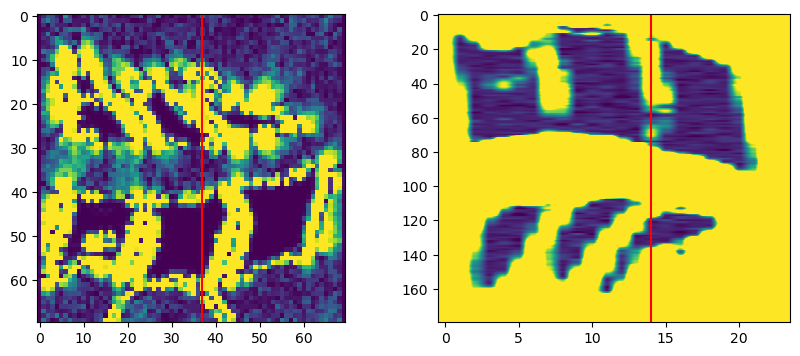

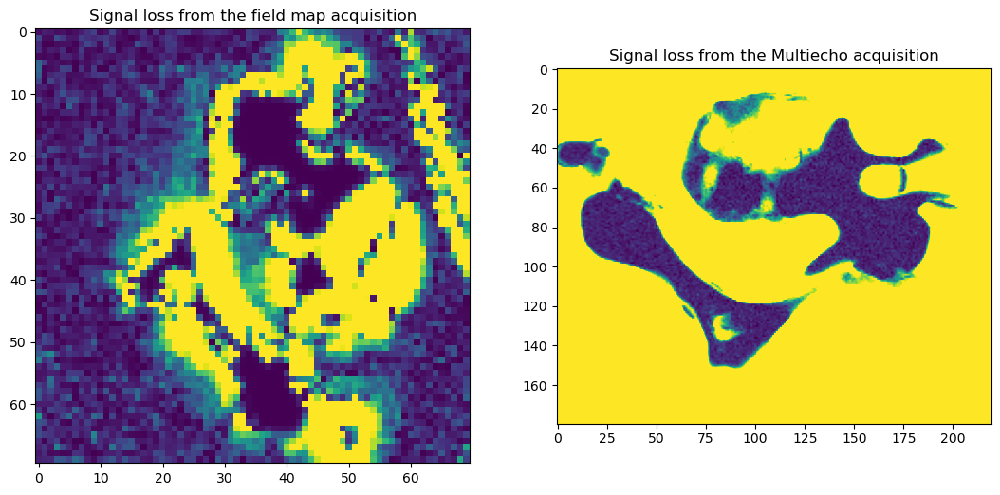

In [43]:
signal_loss_comp(sliceME=14, sigma=0.4)

# T2 map

600 576 25
[2145.93693732    5.55321761  100.31069573]
R² = 0.9636249344218268
echo = 2145.936937320074 * e^(-t/5.553217614417858) +100.31069573226155


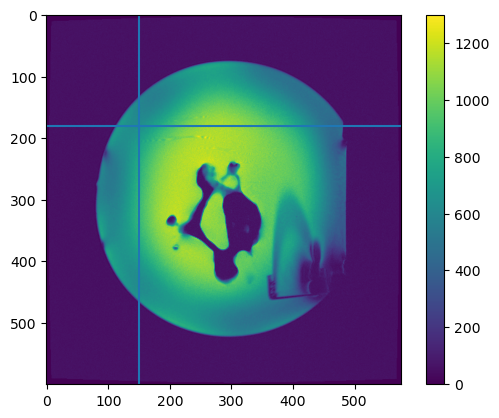

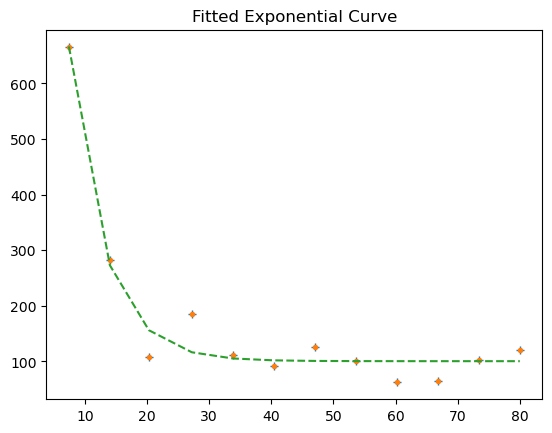

In [44]:
m,n,p = np.shape(mag_12TE[0])
print(m,n,p)
TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms

y, x, z = 180, 150, 5

echo = np.array([mag_12TE[i][y][x][int(z)] for i in range(12)])  #we first try t find the T2 value on one voxel

plt.figure()
plt.imshow(mag_12TE[0][:,:,int(z)])
plt.axvline(x=x)
plt.axhline(y=y)
plt.colorbar()

plt.figure()
plt.plot(TE, echo, "+")
# print(mag_12TE[0][y][x][z])

def monoExp(t, A, T2_star, b):
    return A * np.exp(-t / T2_star) +b

# perform the fit
params, cv = scipy.optimize.curve_fit(monoExp, TE, echo, bounds=(0, [5000, 500, 500]), maxfev=5000)
A, T2_star, b = params

print(params)
# determine quality of the fit
squaredDiffs = np.square(echo - monoExp(TE, A, T2_star, b))
squaredDiffsFromMean = np.square(echo - np.mean(echo))
rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
print(f"R² = {rSquared}")

# plot the results
plt.plot(TE, echo, '.', label="data")
plt.plot(TE, monoExp(TE, A, T2_star, b), '--', label="fitted")
plt.title("Fitted Exponential Curve")

# inspect the parameters
print(f"echo = {A} * e^(-t/{T2_star}) +{b}")


600 576 25
[3942.85094552    4.93639215  195.3087847 ]
R² = 0.9278924465080259
echo = 3942.850945522947 * e^(-t/4.936392152278929) +195.30878470478146


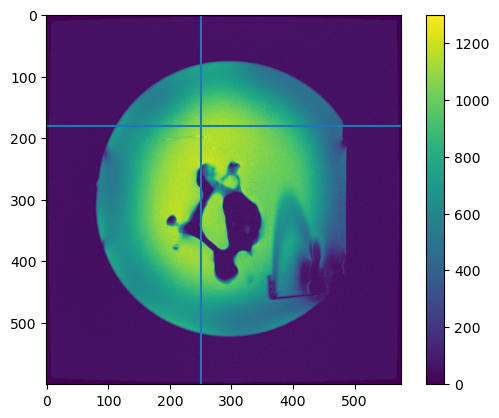

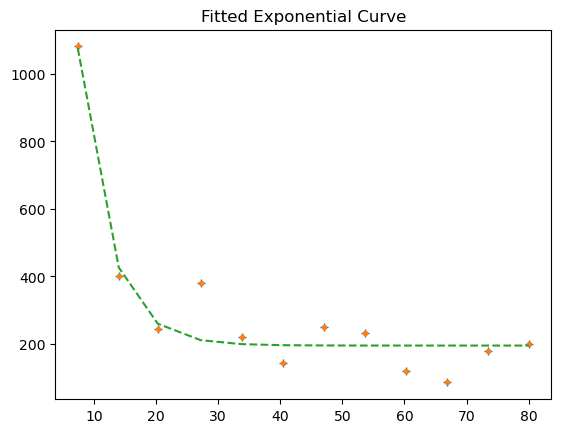

In [45]:
m,n,p = np.shape(mag_12TE[0])
print(m,n,p)
TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms

y, x, z = 180, 250, 5

echo = np.array([mag_12TE[i][y][x][int(z)] for i in range(12)])  #we first try t find the T2 value on one voxel

plt.figure()
plt.imshow(mag_12TE[0][:,:,int(z)])
plt.axvline(x=x)
plt.axhline(y=y)
plt.colorbar()

plt.figure()
plt.plot(TE, echo, "+")
# print(mag_12TE[0][y][x][z])

def monoExp(t, A, T2_star, b):
    return A * np.exp(-t / T2_star) +b

# perform the fit
params, cv = scipy.optimize.curve_fit(monoExp, TE, echo, bounds=(0, [5000, 500, 500]), maxfev=5000)
A, T2_star, b = params

print(params)
# determine quality of the fit
squaredDiffs = np.square(echo - monoExp(TE, A, T2_star, b))
squaredDiffsFromMean = np.square(echo - np.mean(echo))
rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
print(f"R² = {rSquared}")

# plot the results
plt.plot(TE, echo, '.', label="data")
plt.plot(TE, monoExp(TE, A, T2_star, b), '--', label="fitted")
plt.title("Fitted Exponential Curve")

# inspect the parameters
print(f"echo = {A} * e^(-t/{T2_star}) +{b}")
